In [11]:
import utils
import pandas as pd
import DataGenerator
import DeepSpeech2
import config
import CallBack
from scipy.io import wavfile
from IPython import display
import matplotlib.pyplot as plt
import numpy as np


# Data processing

In [12]:
df = pd.read_csv('data/LJSpeech-1.1/metadata.csv', sep='|', header=None)
df.columns = ["filename", "transcript", "col3"]
df = df[["filename", "transcript"]]
split = int(len(df)*0.99)
df_train = df[:split]
df_val = df[split:]

We try to add battle background sound to the input data. the battle sound is taken from https://www.youtube.com/watch?v=nfg5LfwtEv4. We trim only 5 minutes for the video.

In [13]:
sf, battle_sound = wavfile.read("./data/noise/battle_sound.wav")
display.display(display.Audio(np.transpose(battle_sound), rate=16000))

# Noise Visualization

  - Speech audio


  - Transcript: the former will grow down into roots, the latter grow up into the stem and leaves of a vigorous bean-plant,


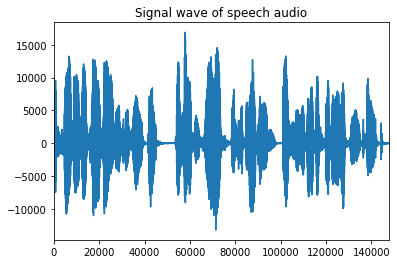

  - Noise audio


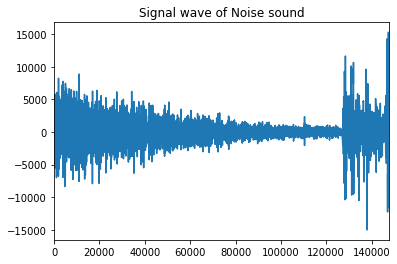

  - Mixed audio with noise_rate = 0.1


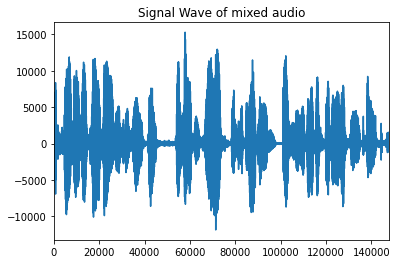

  - Mixed audio with noise_rate = 0.5


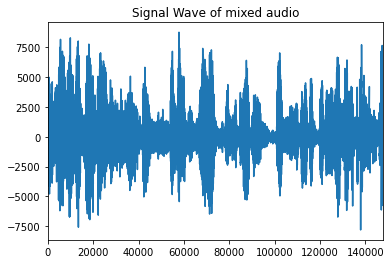

  - Mixed audio with noise_rate = 0.9


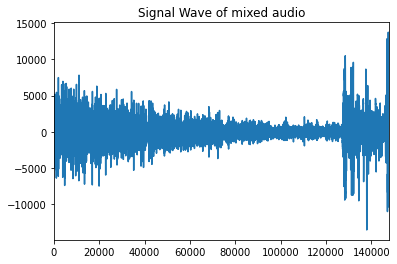

In [14]:
utils.visualization_noise(battle_sound, df_train)

# Model

In [ ]:
#Load DeepSpeech2 that was train on the clean data
model = DeepSpeech2.DeepSpeech2()
try:
    model.load_weights("DeepSpeech2.h5")
except:
    model.load_weights(".SaveModel/DeepSpeech2.h5")

# Evaluate

In [ ]:
noise_rates = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
losses = []
wers = []
for noise_rate in noise_rates:
    print(f"\033[1m EVALUATE THE MODEL WITH NOISE_RATE = {noise_rate} \033[0m")
    noise_valid_generator = DataGenerator.NoiseDataGenerator(df_val, battle_sound, noise_rate = noise_rate)
    loss, wer_score = utils.evaluate(model, noise_valid_generator)
    losses.append(loss)
    wers.append(wer_score)
    print("\n")


 EVALUATE THE MODEL WITH NOISE_RATE = 0 
4/4 [==============================] - 10s 2s/step - loss: 39.1392
 CTC LOSS: 39.14 
 WER: 14% 
**********************************************************************
 Transcript:  and the traditions of the office in a democracy such as ours are so deepseated as to preclude absolute security
 prediction:  and the traditions of the office in a democracy such as hours are so deepseated as to preclude absolute security'
**********************************************************************
 Transcript:  but it seems to warrant further study before each agency becomes irrevocably committed to separate action
 prediction:  but it seems to wart further study before each agency becomes irrevocably committed to separate action'
**********************************************************************
 Transcript:  protecting the president is a difficult and complex task which requires full use of the best resources of many parts of our government
 predicti

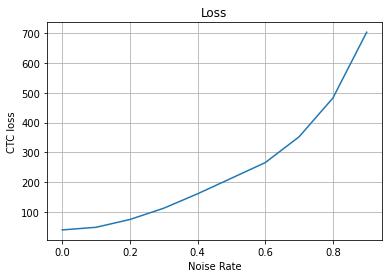

In [ ]:
plt.plot(noise_rates, losses)
plt.title("Loss")
plt.xlabel("Noise Rate")
plt.ylabel("CTC loss")
plt.grid()
plt.show()

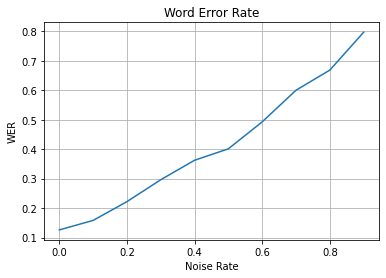

In [ ]:
plt.plot(noise_rates, wers)
plt.title("Word Error Rate")
plt.xlabel("Noise Rate")
plt.ylabel("WER")
plt.grid()
plt.show()

According to the above line chart, the noise_rate negatively impacts the CTC loss and WER of the model. The WER rapidly increases if we increase the noise rate. The model was broken entirely at 98% when the noise_rate= 0.9.

# Noise Training

In [ ]:
# Create the noise data set with noise_rate = 0.9 to train a new model
train_gen_noise =  DataGenerator.NoiseDataGenerator(df_train, battle_sound, noise_rate = 0.9)
valid_gen_noise =  DataGenerator.NoiseDataGenerator(df_val, battle_sound, noise_rate = 0.9)

In [ ]:
# Create a new DeepSpeech2
war_noise_model = model = DeepSpeech2.DeepSpeech2()

In [ ]:
callback = CallBack.callback(df_val)
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath="./CheckPoint/",
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True)

In [ ]:
# Training
war_noise_model.fit(train_gen_noise,
          validation_data =valid_gen_noise,
          epochs = 1,
          callbacks = [callback, checkpoint_callback])

405/405 [==============================] - 1366s 3s/step - loss: 297.0697 - val_loss: 334.8739


WER SCORE: 1.0
***************
Transcript: it makes no use of the recent developments in automatic data processing which are widely used in the business world and in other government offices
prediction: 
***************
Transcript: but it seems to warrant further study before each agency becomes irrevocably committed to separate action
prediction: 
***************


In practice, we should train the model with 30 epochs. Here, we will load the weights that was train by 30 epochs

In [ ]:
try:
    war_noise_model.load_weights("battle_noise_model.h5")
except:
    war_noise_model.load_weights(".SaveModel/battle_noise_model.h5")

In [ ]:
noise_rates = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
losses = []
wers = []
for noise_rate in noise_rates:
    print(f"\033[1m EVALUATE THE MODEL WITH NOISE_RATE = {noise_rate} \033[0m")
    valid_gen_noise = DataGenerator.NoiseDataGenerator(df_val, battle_sound, noise_rate = noise_rate)
    loss, wer_score = utils.evaluate(war_noise_model, valid_gen_noise)
    losses.append(loss)
    wers.append(wer_score)
    print("\n")

 EVALUATE THE MODEL WITH NOISE_RATE = 0 
4/4 [==============================] - 8s 2s/step - loss: 49.5275
 CTC LOSS: 49.53 
 WER: 17% 
**********************************************************************
 Transcript:  the plan provides for an additional  agents for the secret service seventeen of this number are proposed for the protective research section
 prediction:  the plan provides for an additional unredf agents for the secret service  of this number up proposed for the protective research section''''
**********************************************************************
 Transcript:  with the particular purposes of the agency involved the commission recognizes that this is a controversial area
 prediction:  with the particular purposes of the agency involved the commission recognizes that this is a controversial area'''
**********************************************************************
 Transcript:  this prs agent will also be responsible for establishing an informal loc

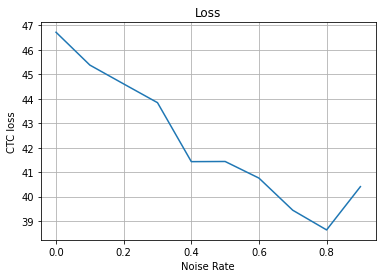

In [ ]:
plt.plot(noise_rates, losses)
plt.title("Loss")
plt.xlabel("Noise Rate")
plt.ylabel("CTC loss")
plt.grid()
plt.show()

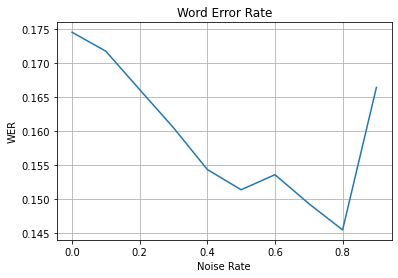

In [ ]:
plt.plot(noise_rates, wers)
plt.title("Word Error Rate")
plt.xlabel("Noise Rate")
plt.ylabel("WER")
plt.grid()
plt.show()

The noise training model is better than the original model because the WER does not rapidly increase if the noise_rate rises.